In [1]:
#@markdown Check type of GPU and VRAM available.
!nvidia-smi --query-gpu=name,memory.total,memory.free --format=csv,noheader

NVIDIA RTX A6000, 49140 MiB, 48674 MiB


In [2]:
!pip uninstall -y google-api-python-client

https://github.com/ShivamShrirao/diffusers/tree/main/examples/dreambooth

## Install Requirements

In [3]:
!pwd

/workspace/ds_nickfarrell


In [4]:
# Run for the first time only
!wget -q https://github.com/ShivamShrirao/diffusers/raw/main/examples/dreambooth/train_dreambooth.py
!wget -q https://github.com/ShivamShrirao/diffusers/raw/main/scripts/convert_diffusers_to_original_stable_diffusion.py

In [5]:
%pip install -qq git+https://github.com/ShivamShrirao/diffusers
%pip install -q -U --pre triton==2.0.0
%pip install -q accelerate transformers ftfy bitsandbytes==0.35.0 gradio natsort safetensors xformers

Note: you may need to restart the kernel to use updated packages.
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchaudio 2.1.0+cu118 requires torch==2.1.0, but you have torch 2.0.1 which is incompatible.
torchvision 0.16.0+cu118 requires torch==2.1.0, but you have torch 2.0.1 which is incompatible.
xformers 0.0.24 requires torch==2.2.0, but you have torch 2.0.1 which is incompatible.

[notice] A new release of pip is available: 23.3.1 -> 24.0
[notice] To update, run: python -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchaudio 2.1.0+cu118 requires torch==2.1.0, but you have torch 2.2.0 which is incompatible.
torchvision 0.16.0+cu118 r

In [7]:
import accelerate

In [2]:
#@title Login to HuggingFace 🤗

#@markdown You need to accept the model license before downloading or using the Stable Diffusion weights. Please, visit the [model card](https://huggingface.co/runwayml/stable-diffusion-v1-5), read the license and tick the checkbox if you agree. You have to be a registered user in 🤗 Hugging Face Hub, and you'll also need to use an access token for the code to work.
# https://huggingface.co/settings/tokens
!mkdir -p ~/.huggingface
HUGGINGFACE_TOKEN = "" #@param {type:"string"}
!echo -n "{HUGGINGFACE_TOKEN}" > ~/.huggingface/token

In [8]:
!pip install Pillow pyheif


[notice] A new release of pip is available: 23.3.1 -> 24.0
[notice] To update, run: python -m pip install --upgrade pip


In [9]:
def load_image(file_path):  
    if file_path.split('.')[-1] == 'heic':
        heif_file = pyheif.read(file_path)
        image = Image.frombytes(heif_file.mode, heif_file.size, heif_file.data, "raw", heif_file.mode, heif_file.stride)
    else:  
        image = Image.open(file_path)
    return image

In [10]:
import os
import re
from PIL import Image, ImageOps
import pyheif 

def crop_image(im, resoulution = 512):
    im = ImageOps.exif_transpose(im)
    (x, y) = im.size
    min_sz = min(x, y)
    x_crop = max(0, x - min_sz) / 2;
    y_crop = max(0, y - min_sz) / 3
    left = x_crop
    right = x - x_crop
    top = y_crop
    bottom = y - y_crop * 2
    img1 = im.crop((left, top, right, bottom))
    return img1.resize((resoulution, resoulution))
    
def resize_all(path, resoulution = 512):
    all_files = os.listdir(path)
    image_list = []
    idx = 1
    if not os.path.exists(os.path.join(path, 'cropped')):
        os.mkdir(os.path.join(path, 'cropped'))
        #os.mkdir(os.path.join(path, 'cropped'))
    for x in all_files:
        if len(re.findall('.jpg|.png|.jpeg|.heic', x)) > 0:
            # im = Image.open(os.path.join(path, x))
            im = load_image(os.path.join(path, x))
            cropped = crop_image(im, resoulution)
            print(os.path.join(path,'cropped', ''.join(x.split('.')[0:-1])+'.jpg'))
            cropped.save(os.path.join(path,'cropped', ''.join(x.split('.')[0:-1])+'.jpg'))                
    return

In [16]:
resize_all('data/Drew', 512)

FileNotFoundError: [Errno 2] No such file or directory: 'data/Drew'

## Settings and run

In [17]:
#@markdown If model weights should be saved directly in google drive (takes around 4-5 GB).
save_to_gdrive = False #@param {type:"boolean"}
if save_to_gdrive:
    from google.colab import drive
    drive.mount('/content/drive')

#@markdown Name/Path of the initial model.
# MODEL_NAME = "runwayml/stable-diffusion-v1-5" #@param {type:"string"}
MODEL_NAME = "dreamlike-art/dreamlike-photoreal-2.0"
# MODEL_NAME = "SG161222/Realistic_Vision_V5.1_noVAE"


#@markdown Enter the directory name to save model at.

OUTPUT_DIR = "data/a9e1bcf2-ae89-40db-bac3-f0ee248c1dda/stable_diffusion_weights/a9e1bcf2-ae89-40db-bac3-f0ee248c1dda" #@param {type:"string"}

print(f"[*] Weights will be saved at {OUTPUT_DIR}")

!mkdir -p $OUTPUT_DIR

[*] Weights will be saved at data/a9e1bcf2-ae89-40db-bac3-f0ee248c1dda/stable_diffusion_weights/a9e1bcf2-ae89-40db-bac3-f0ee248c1dda


# Start Training

Use the table below to choose the best flags based on your memory and speed requirements. Tested on Tesla T4 GPU.


| `fp16` | `train_batch_size` | `gradient_accumulation_steps` | `gradient_checkpointing` | `use_8bit_adam` | GB VRAM usage | Speed (it/s) |
| ---- | ------------------ | ----------------------------- | ----------------------- | --------------- | ---------- | ------------ |
| fp16 | 1                  | 1                             | TRUE                    | TRUE            | 9.92       | 0.93         |
| no   | 1                  | 1                             | TRUE                    | TRUE            | 10.08      | 0.42         |
| fp16 | 2                  | 1                             | TRUE                    | TRUE            | 10.4       | 0.66         |
| fp16 | 1                  | 1                             | FALSE                   | TRUE            | 11.17      | 1.14         |
| no   | 1                  | 1                             | FALSE                   | TRUE            | 11.17      | 0.49         |
| fp16 | 1                  | 2                             | TRUE                    | TRUE            | 11.56      | 1            |
| fp16 | 2                  | 1                             | FALSE                   | TRUE            | 13.67      | 0.82         |
| fp16 | 1                  | 2                             | FALSE                   | TRUE            | 13.7       | 0.83          |
| fp16 | 1                  | 1                             | TRUE                    | FALSE           | 15.79      | 0.77         |


Add `--gradient_checkpointing` flag for around 9.92 GB VRAM usage.

remove `--use_8bit_adam` flag for full precision. Requires 15.79 GB with `--gradient_checkpointing` else 17.8 GB.

remove `--train_text_encoder` flag to reduce memory usage further, degrades output quality.

In [24]:
# You can also add multiple concepts here. Try tweaking `--max_train_steps` accordingly.

concepts_list = [
    {
        "instance_prompt":      "photo of X123 person",
        "class_prompt":         "photo of a person",
        "instance_data_dir":    "/workspace/ds_nickfarrell/data/010f12b9-41e5-4ce2-808c-48036be68a89/010f12b9-41e5-4ce2-808c-48036be68a89/cropped",
        "class_data_dir":       "/workspace/ds_nickfarrell/data/person/"
    }
    # {
#         "instance_prompt":      "photo of ukj person",
#         "class_prompt":         "photo of a person",
#         "instance_data_dir":    "/content/data/ukj",
#         "class_data_dir":       "/content/data/person"
#     }
]

# `class_data_dir` contains regularization images
import json
import os
for c in concepts_list:
    os.makedirs(c["instance_data_dir"], exist_ok=True)

with open("concepts_list.json", "w") as f:
    json.dump(concepts_list, f, indent=4)

In [19]:
#@markdown Upload your images by running this cell.

#@markdown OR

#@markdown You can use the file manager on the left panel to upload (drag and drop) to each `instance_data_dir` (it uploads faster). You can also upload your own class images in `class_data_dir` if u don't wanna generate with SD.

import os
from google.colab import files
import shutil

for c in concepts_list:
    print(f"Uploading instance images for `{c['instance_prompt']}`")
    uploaded = files.upload()
    for filename in uploaded.keys():
        dst_path = os.path.join(c['instance_data_dir'], filename)
        shutil.move(filename, dst_path)

ModuleNotFoundError: No module named 'google'

In [25]:
!python3 train_dreambooth.py \
  --pretrained_model_name_or_path="dreamlike-art/dreamlike-photoreal-2.0" \
  --pretrained_vae_name_or_path="stabilityai/sd-vae-ft-mse" \
  --output_dir="data/010f12b9-41e5-4ce2-808c-48036be68a89/stable_diffusion_weights/010f12b9-41e5-4ce2-808c-48036be68a89" \
  --with_prior_preservation --prior_loss_weight=1.0 \
  --seed=1337 \
  --resolution=512 \
  --train_batch_size=1 \
  --train_text_encoder \
  --mixed_precision="fp16" \
  --use_8bit_adam \
  --gradient_accumulation_steps=1 \
  --learning_rate=1e-6 \
  --lr_scheduler="constant" \
  --lr_warmup_steps=30 \
  --num_class_images=69 \
  --sample_batch_size=4 \
  --max_train_steps=1200 \
  --save_interval=600 \
  --save_sample_prompt="photo of X123 person" \
  --concepts_list="/workspace/ds_nickfarrell/data/010f12b9-41e5-4ce2-808c-48036be68a89/concepts_list.json"

# Reduce the `--save_interval` to lower than `--max_train_steps` to save weights from intermediate steps.
# `--save_sample_prompt` can be same as `--instance_prompt` to generate intermediate samples (saved along with weights in samples directory).

/usr/local/lib/python3.10/dist-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: '/usr/local/lib/python3.10/dist-packages/torchvision/image.so: undefined symbol: _ZN3c1017RegisterOperatorsD1Ev'If you don't plan on using image functionality from `torchvision.io`, you can ignore this warning. Otherwise, there might be something wrong with your environment. Did you have `libjpeg` or `libpng` installed before building `torchvision` from source?
  warn(
Namespace(pretrained_model_name_or_path='dreamlike-art/dreamlike-photoreal-2.0', pretrained_vae_name_or_path='stabilityai/sd-vae-ft-mse', revision=None, tokenizer_name=None, instance_data_dir=None, class_data_dir=None, instance_prompt=None, class_prompt=None, save_sample_prompt='photo of X123 person', save_sample_negative_prompt=None, n_save_sample=4, save_guidance_scale=7.5, save_infer_steps=20, pad_tokens=False, with_prior_preservation=True, prior_loss_weight=1.0, num_class_images=69, output_dir='data

In [26]:
# #@markdown Specify the weights directory to use (leave blank for latest)
# WEIGHTS_DIR = "" #@param {type:"string"}
# if WEIGHTS_DIR == "":
#     from natsort import natsorted
#     from glob import glob
#     import os
#     WEIGHTS_DIR = natsorted(glob(OUTPUT_DIR + os.sep + "*"))[-1]
# print(f"[*] WEIGHTS_DIR={WEIGHTS_DIR}")
WEIGHTS_DIR= '/workspace/ds_nickfarrell/data/010f12b9-41e5-4ce2-808c-48036be68a89/stable_diffusion_weights/010f12b9-41e5-4ce2-808c-48036be68a89/600'

## Convert weights to ckpt to use in web UIs like AUTOMATIC1111.

In [27]:
#@markdown Run conversion.
ckpt_path = WEIGHTS_DIR + "/model.ckpt"

half_arg = ""
#@markdown  Whether to convert to fp16, takes half the space (2GB).
fp16 = True #@param {type: "boolean"}
if fp16:
    half_arg = "--half"
!python convert_diffusers_to_original_stable_diffusion.py --model_path $WEIGHTS_DIR  --checkpoint_path $ckpt_path $half_arg
print(f"[*] Converted ckpt saved at {ckpt_path}")

Reshaping encoder.mid.attn_1.q.weight for SD format
Reshaping encoder.mid.attn_1.k.weight for SD format
Reshaping encoder.mid.attn_1.v.weight for SD format
Reshaping encoder.mid.attn_1.proj_out.weight for SD format
Reshaping decoder.mid.attn_1.q.weight for SD format
Reshaping decoder.mid.attn_1.k.weight for SD format
Reshaping decoder.mid.attn_1.v.weight for SD format
Reshaping decoder.mid.attn_1.proj_out.weight for SD format
[*] Converted ckpt saved at /workspace/ds_nickfarrell/data/010f12b9-41e5-4ce2-808c-48036be68a89/stable_diffusion_weights/010f12b9-41e5-4ce2-808c-48036be68a89/600/model.ckpt


## Inference

In [28]:
import torch
from torch import autocast
from diffusers import StableDiffusionPipeline, DDIMScheduler, DDPMScheduler
from IPython.display import display

# model_path = WEIGHTS_DIR             # If you want to use previously trained model saved in gdrive, replace this with the full path of model in gdrive
model_path = "/workspace/ds_nickfarrell/data/010f12b9-41e5-4ce2-808c-48036be68a89/stable_diffusion_weights/010f12b9-41e5-4ce2-808c-48036be68a89/600/"
pipe = StableDiffusionPipeline.from_pretrained(model_path, safety_checker=None, torch_dtype=torch.float16).to("cuda")
pipe.scheduler = DDPMScheduler.from_config(pipe.scheduler.config)
pipe.enable_xformers_memory_efficient_attention()
g_cuda = None

In [29]:
#@markdown Can set random seed here for reproducibility.


8262727322295171


  0%|          | 0/50 [00:00<?, ?it/s]

[<PIL.Image.Image image mode=RGB size=512x512 at 0x7F878E347DC0>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F878E347BE0>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F878E20A3E0>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F878E208220>]
7875084026733442


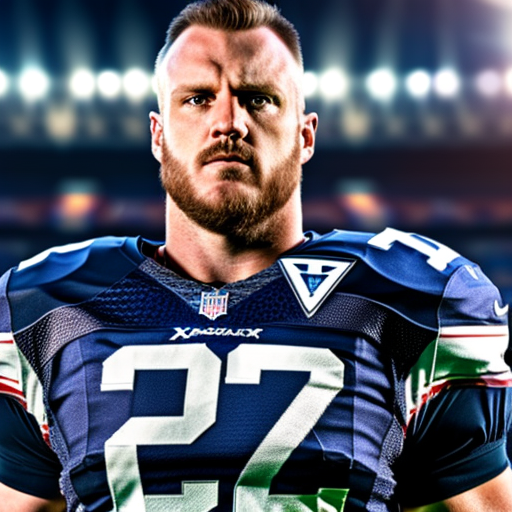

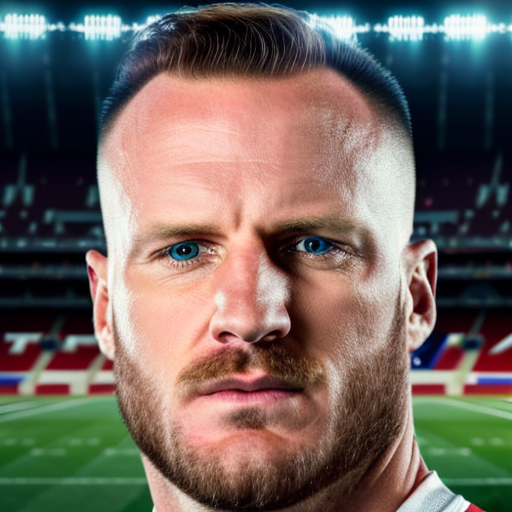

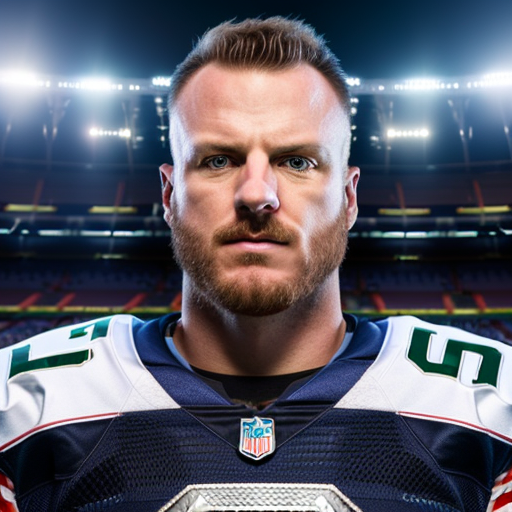

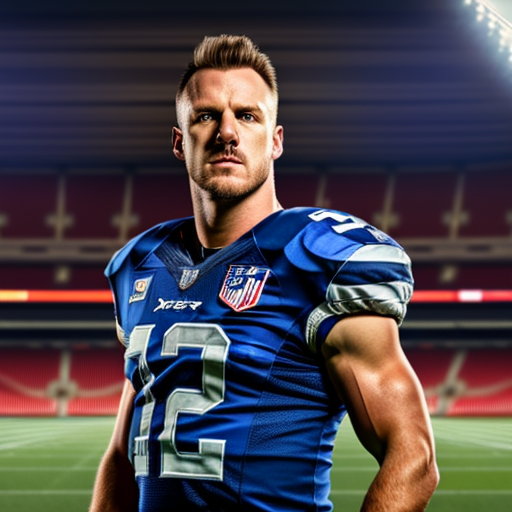

In [33]:
#@title Run for generating images.
import random
g_cuda = torch.Generator(device='cuda')
seed = random.randint(1, 1e16 -1)#@param {type:"number"}
# seed = 4856845480668637
# seed = 288395944327328
g_cuda.manual_seed(seed)
print(seed)

prompt = "closeup portrait of X123 as a male American footballer with perfect facial features, sporty body. Standing in a stadium wearing football team jersey. Chest level portrait. Octane render, 8K HDR." #@param {type:"string"}
negative_prompt = "multiple person, person in the background, crossed eyes, ((full body)), bare body, ((logo)), blur, freckles, childish, text, symbols" #@param {type:"string"}
num_samples = 4 #@param {type:"number"}
guidance_scale = 14 #@param {type:"number"}
num_inference_steps = 50 #@param {type:"number"}
height = 512 #@param {type:"number"}
width = 512 #@param {type:"number"}


with autocast("cuda"), torch.inference_mode():
    response = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    )
    images = response.images
    print(response.images)
    print(g_cuda.seed())

for img in images:
    display(img)

# a hyper detailed photo realistic horror character portrait, 1 9 8 0 by john totleben, Darrell K Sweet, Wes Wilson, Mark Brooks depicting an alien cyborg [[theCyborg Hacker]], cyberpunk, character portrait

# Inference using 1200

Reshaping encoder.mid.attn_1.q.weight for SD format
Reshaping encoder.mid.attn_1.k.weight for SD format
Reshaping encoder.mid.attn_1.v.weight for SD format
Reshaping encoder.mid.attn_1.proj_out.weight for SD format
Reshaping decoder.mid.attn_1.q.weight for SD format
Reshaping decoder.mid.attn_1.k.weight for SD format
Reshaping decoder.mid.attn_1.v.weight for SD format
Reshaping decoder.mid.attn_1.proj_out.weight for SD format
[*] Converted ckpt saved at /workspace/ds_nickfarrell/data/010f12b9-41e5-4ce2-808c-48036be68a89/stable_diffusion_weights/010f12b9-41e5-4ce2-808c-48036be68a89/1200/model.ckpt
234465922215890


  0%|          | 0/50 [00:00<?, ?it/s]

[<PIL.Image.Image image mode=RGB size=512x512 at 0x7F878E3F7B50>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F878E3F6AA0>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F878E3F7AC0>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F878E3F50F0>]
3797245551226839


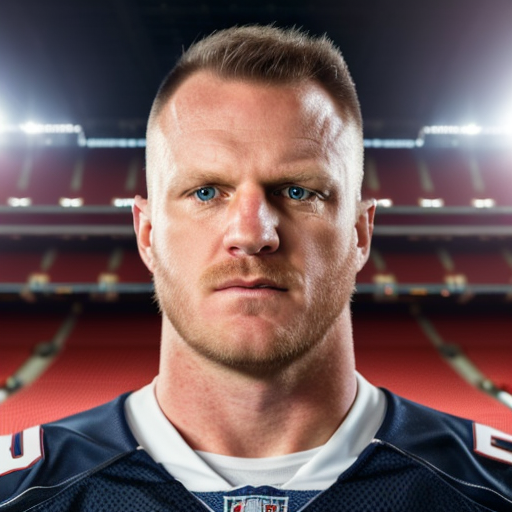

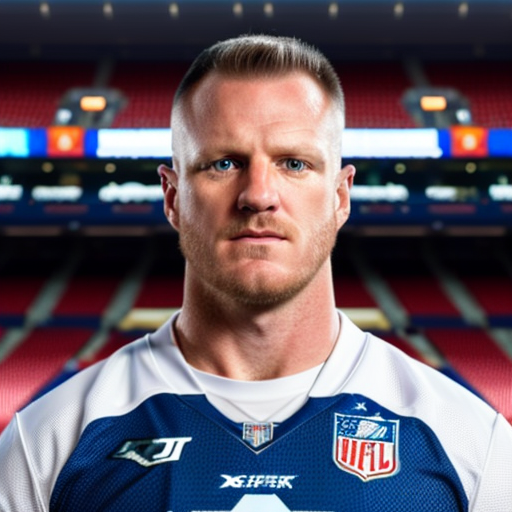

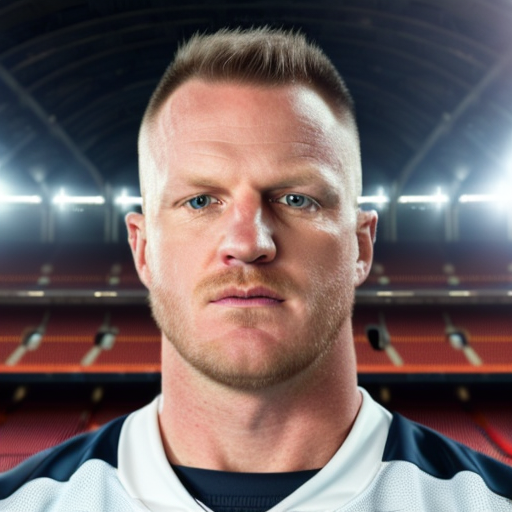

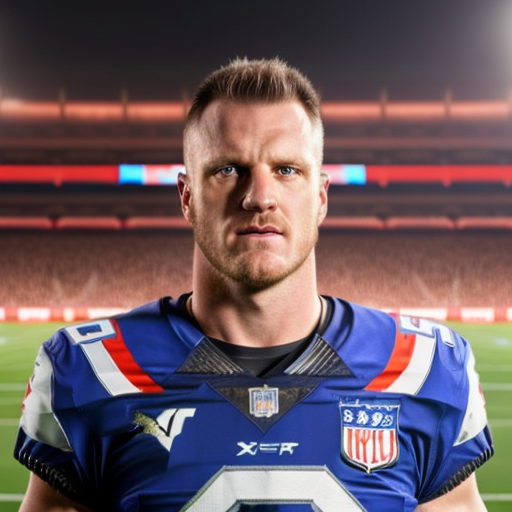

In [39]:
WEIGHTS_DIR= '/workspace/ds_nickfarrell/data/010f12b9-41e5-4ce2-808c-48036be68a89/stable_diffusion_weights/010f12b9-41e5-4ce2-808c-48036be68a89/1200'
ckpt_path = WEIGHTS_DIR + "/model.ckpt"

half_arg = ""
#@markdown  Whether to convert to fp16, takes half the space (2GB).
fp16 = True #@param {type: "boolean"}
if fp16:
    half_arg = "--half"
!python convert_diffusers_to_original_stable_diffusion.py --model_path $WEIGHTS_DIR  --checkpoint_path $ckpt_path $half_arg
print(f"[*] Converted ckpt saved at {ckpt_path}")
import torch
from torch import autocast
from diffusers import StableDiffusionPipeline, DDIMScheduler, DDPMScheduler
from IPython.display import display

# model_path = WEIGHTS_DIR             # If you want to use previously trained model saved in gdrive, replace this with the full path of model in gdrive
model_path = "/workspace/ds_nickfarrell/data/010f12b9-41e5-4ce2-808c-48036be68a89/stable_diffusion_weights/010f12b9-41e5-4ce2-808c-48036be68a89/1200/"
pipe = StableDiffusionPipeline.from_pretrained(model_path, safety_checker=None, torch_dtype=torch.float16).to("cuda")
pipe.scheduler = DDPMScheduler.from_config(pipe.scheduler.config)
pipe.enable_xformers_memory_efficient_attention()
g_cuda = None
#@title Run for generating images.
import random
g_cuda = torch.Generator(device='cuda')
seed = random.randint(1, 1e16 -1)#@param {type:"number"}
# seed = 4856845480668637
# seed = 8074443700393921
g_cuda.manual_seed(seed)
print(seed)

prompt = "closeup portrait of X123 as a male American footballer with perfect facial features, sporty body. Standing in a stadium wearing football team jersey. Chest level portrait. Octane render, 8K HDR." #@param {type:"string"}
negative_prompt = "multiple person, person in the background, crossed eyes, ((full body)), bare body, ((logo)), blur, freckles, childish, text, symbols" #@param {type:"string"}
num_samples = 4 #@param {type:"number"}
guidance_scale = 14 #@param {type:"number"}
num_inference_steps = 50 #@param {type:"number"}
height = 512 #@param {type:"number"}
width = 512 #@param {type:"number"}


with autocast("cuda"), torch.inference_mode():
    response = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    )
    images = response.images
    print(response.images)
    print(g_cuda.seed())

for img in images:
    display(img)

# a hyper detailed photo realistic horror character portrait, 1 9 8 0 by john totleben, Darrell K Sweet, Wes Wilson, Mark Brooks depicting an alien cyborg [[theCyborg Hacker]], cyberpunk, character portrait

In [37]:
import uuid

In [38]:
str(uuid.uuid4())

'8b2df97a-7112-400a-9761-f7835e8f46ff'

In [40]:
!pwd

/workspace/ds_nickfarrell


In [41]:
%cd data/

/workspace/ds_nickfarrell/data


/usr/local/lib/python3.10/dist-packages/IPython/core/magics/osm.py:417: UserWarning: using dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


In [42]:
!pwd

/workspace/ds_nickfarrell/data


In [43]:
!mkdir 8b2df97a-7112-400a-9761-f7835e8f46ff

In [46]:
%cd 8b2df97a-7112-400a-9761-f7835e8f46ff

/workspace/ds_nickfarrell/data/8b2df97a-7112-400a-9761-f7835e8f46ff


In [47]:
!pwd

/workspace/ds_nickfarrell/data/8b2df97a-7112-400a-9761-f7835e8f46ff


# Testing with other images

In [53]:
# import os
# import re
# from PIL import Image, ImageOps
# import pyheif 

# def crop_image(im, resoulution = 512):
#     im = ImageOps.exif_transpose(im)
#     (x, y) = im.size
#     min_sz = min(x, y)
#     x_crop = max(0, x - min_sz) / 2;
#     y_crop = max(0, y - min_sz) / 3
#     left = x_crop
#     right = x - x_crop
#     top = y_crop
#     bottom = y - y_crop * 2
#     img1 = im.crop((left, top, right, bottom))
#     return img1.resize((resoulution, resoulution))
    
# def resize_all(path, resoulution = 512):
#     all_files = os.listdir(path)
#     image_list = []
#     idx = 1
#     os.mkdir(os.path.join(path, 'cropped'))
#     for x in all_files:
#         if len(re.findall('.jpg|.png|.jpeg|.heic', x)) > 0:
#             # im = Image.open(os.path.join(path, x))
#             im = load_image(os.path.join(path, x))
#             cropped = crop_image(im, resoulution)
#             print(os.path.join(path,'cropped', ''.join(x.split('.')[0:-1])+'.jpg'))
#             cropped.save(os.path.join(path,'cropped', ''.join(x.split('.')[0:-1])+'.jpg'))                
#     return

In [58]:
import os
import re
from PIL import Image, ImageOps
import pyheif

def load_image(file_path):
    ext = os.path.splitext(file_path)[1].lower()
    if ext == '.heic':
        heif_file = pyheif.read(file_path)
        return Image.frombytes(
            heif_file.mode, 
            heif_file.size, 
            heif_file.data,
            "raw",
            heif_file.mode,
            heif_file.stride,
        )
    else:
        return Image.open(file_path)

def crop_image(im, resolution=512):
    im = ImageOps.exif_transpose(im)
    (x, y) = im.size
    min_sz = min(x, y)
    left = (x - min_sz) / 2
    top = (y - min_sz) / 2
    right = x - left
    bottom = y - top
    img1 = im.crop((left, top, right, bottom))
    return img1.resize((resolution, resolution))
    
def resize_all(path, resolution=512):
    all_files = os.listdir(path)
    cropped_path = os.path.join(path, 'cropped')
    if not os.path.exists(cropped_path):
        os.mkdir(cropped_path)
    
    for x in all_files:
        if re.search(r'\.(jpg|png|jpeg|heic)$', x, re.IGNORECASE):
            im = load_image(os.path.join(path, x))
            cropped = crop_image(im, resolution)
            new_filename = ''.join(x.split('.')[:-1]) + '.jpg'
            cropped.save(os.path.join(cropped_path, new_filename))

resize_all("/workspace/ds_nickfarrell/data/8b2df97a-7112-400a-9761-f7835e8f46ff/8b2df97a-7112-400a-9761-f7835e8f46ff", 512)


In [59]:
os.listdir("/workspace/ds_nickfarrell/data/8b2df97a-7112-400a-9761-f7835e8f46ff/8b2df97a-7112-400a-9761-f7835e8f46ff")

['DSC01500.JPG',
 'DSC01498.JPG',
 'DSC01531.JPG',
 'DSC01502.JPG',
 'DSC01525.JPG',
 'DSC01492.JPG',
 'DSC01526.JPG',
 'DSC01497.JPG',
 'DSC01530.JPG',
 'DSC01501.JPG',
 'cropped']

In [60]:
# You can also add multiple concepts here. Try tweaking `--max_train_steps` accordingly.

concepts_list = [
    {
        "instance_prompt":      "photo of X123 person",
        "class_prompt":         "photo of a person",
        "instance_data_dir":    "/workspace/ds_nickfarrell/data/8b2df97a-7112-400a-9761-f7835e8f46ff/8b2df97a-7112-400a-9761-f7835e8f46ff/cropped",
        "class_data_dir":       "/workspace/ds_nickfarrell/data/person/"
    }
    # {
#         "instance_prompt":      "photo of ukj person",
#         "class_prompt":         "photo of a person",
#         "instance_data_dir":    "/content/data/ukj",
#         "class_data_dir":       "/content/data/person"
#     }
]

# `class_data_dir` contains regularization images
import json
import os
for c in concepts_list:
    os.makedirs(c["instance_data_dir"], exist_ok=True)

with open("concepts_list.json", "w") as f:
    json.dump(concepts_list, f, indent=4)

In [61]:
#@markdown Name/Path of the initial model.
# MODEL_NAME = "runwayml/stable-diffusion-v1-5" #@param {type:"string"}
MODEL_NAME = "dreamlike-art/dreamlike-photoreal-2.0"
# MODEL_NAME = "SG161222/Realistic_Vision_V5.1_noVAE"


#@markdown Enter the directory name to save model at.

OUTPUT_DIR = "/workspace/ds_nickfarrell/data/8b2df97a-7112-400a-9761-f7835e8f46ff/stable_diffusion_weights/8b2df97a-7112-400a-9761-f7835e8f46ff" #@param {type:"string"}

print(f"[*] Weights will be saved at {OUTPUT_DIR}")

!mkdir -p $OUTPUT_DIR

[*] Weights will be saved at /workspace/ds_nickfarrell/data/8b2df97a-7112-400a-9761-f7835e8f46ff/stable_diffusion_weights/8b2df97a-7112-400a-9761-f7835e8f46ff


In [3]:
!python3 train_dreambooth.py \
  --pretrained_model_name_or_path="dreamlike-art/dreamlike-photoreal-2.0" \
  --pretrained_vae_name_or_path="stabilityai/sd-vae-ft-mse" \
  --output_dir="data/8b2df97a-7112-400a-9761-f7835e8f46ff/stable_diffusion_weights/8b2df97a-7112-400a-9761-f7835e8f46ff" \
  --with_prior_preservation --prior_loss_weight=1.0 \
  --seed=1337 \
  --resolution=512 \
  --train_batch_size=1 \
  --train_text_encoder \
  --mixed_precision="fp16" \
  --use_8bit_adam \
  --gradient_accumulation_steps=1 \
  --learning_rate=1e-6 \
  --lr_scheduler="constant" \
  --lr_warmup_steps=30 \
  --num_class_images=69 \
  --sample_batch_size=4 \
  --max_train_steps=1800 \
  --save_interval=600 \
  --save_sample_prompt="photo of X123 person" \
  --concepts_list="/workspace/ds_nickfarrell/data/8b2df97a-7112-400a-9761-f7835e8f46ff/concepts_list.json"

# Reduce the `--save_interval` to lower than `--max_train_steps` to save weights from intermediate steps.
# `--save_sample_prompt` can be same as `--instance_prompt` to generate intermediate samples (saved along with weights in samples directory).

/usr/local/lib/python3.10/dist-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: '/usr/local/lib/python3.10/dist-packages/torchvision/image.so: undefined symbol: _ZN3c1017RegisterOperatorsD1Ev'If you don't plan on using image functionality from `torchvision.io`, you can ignore this warning. Otherwise, there might be something wrong with your environment. Did you have `libjpeg` or `libpng` installed before building `torchvision` from source?
  warn(
Namespace(pretrained_model_name_or_path='dreamlike-art/dreamlike-photoreal-2.0', pretrained_vae_name_or_path='stabilityai/sd-vae-ft-mse', revision=None, tokenizer_name=None, instance_data_dir=None, class_data_dir=None, instance_prompt=None, class_prompt=None, save_sample_prompt='photo of X123 person', save_sample_negative_prompt=None, n_save_sample=4, save_guidance_scale=7.5, save_infer_steps=20, pad_tokens=False, with_prior_preservation=True, prior_loss_weight=1.0, num_class_images=69, output_dir='data

In [8]:
WEIGHTS_DIR= '/workspace/ds_nickfarrell/data/8b2df97a-7112-400a-9761-f7835e8f46ff/stable_diffusion_weights/8b2df97a-7112-400a-9761-f7835e8f46ff/1200'

In [9]:
#@markdown Run conversion.
ckpt_path = WEIGHTS_DIR + "/model.ckpt"

half_arg = ""
#@markdown  Whether to convert to fp16, takes half the space (2GB).
fp16 = True #@param {type: "boolean"}
if fp16:
    half_arg = "--half"
!python convert_diffusers_to_original_stable_diffusion.py --model_path $WEIGHTS_DIR  --checkpoint_path $ckpt_path $half_arg
print(f"[*] Converted ckpt saved at {ckpt_path}")

Reshaping encoder.mid.attn_1.q.weight for SD format
Reshaping encoder.mid.attn_1.k.weight for SD format
Reshaping encoder.mid.attn_1.v.weight for SD format
Reshaping encoder.mid.attn_1.proj_out.weight for SD format
Reshaping decoder.mid.attn_1.q.weight for SD format
Reshaping decoder.mid.attn_1.k.weight for SD format
Reshaping decoder.mid.attn_1.v.weight for SD format
Reshaping decoder.mid.attn_1.proj_out.weight for SD format
[*] Converted ckpt saved at /workspace/ds_nickfarrell/data/8b2df97a-7112-400a-9761-f7835e8f46ff/stable_diffusion_weights/8b2df97a-7112-400a-9761-f7835e8f46ff/1200/model.ckpt


In [10]:
import torch
from torch import autocast
from diffusers import StableDiffusionPipeline, DDIMScheduler, DDPMScheduler
from IPython.display import display

# model_path = WEIGHTS_DIR             # If you want to use previously trained model saved in gdrive, replace this with the full path of model in gdrive
model_path = "/workspace/ds_nickfarrell/data/8b2df97a-7112-400a-9761-f7835e8f46ff/stable_diffusion_weights/8b2df97a-7112-400a-9761-f7835e8f46ff/1200/"
pipe = StableDiffusionPipeline.from_pretrained(model_path, safety_checker=None, torch_dtype=torch.float16).to("cuda")
pipe.scheduler = DDPMScheduler.from_config(pipe.scheduler.config)
pipe.enable_xformers_memory_efficient_attention()
g_cuda = None

4344203704173574


  0%|          | 0/50 [00:00<?, ?it/s]

[<PIL.Image.Image image mode=RGB size=512x512 at 0x7F0D7C2BED70>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F0D7C2BD720>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F0E271B5330>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F0E271B5D80>]
1392014790972906


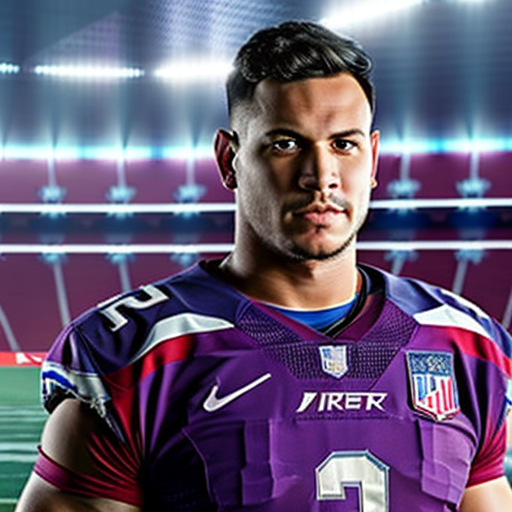

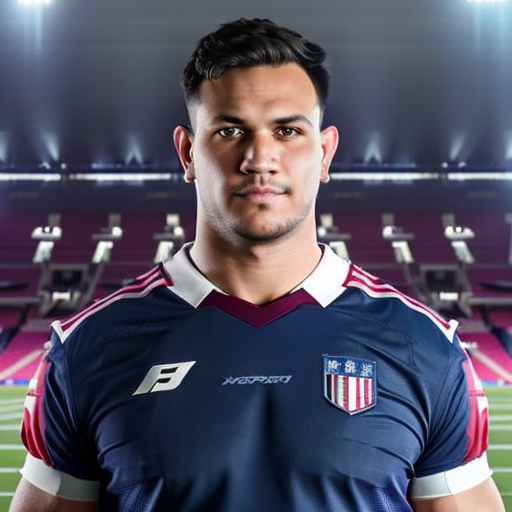

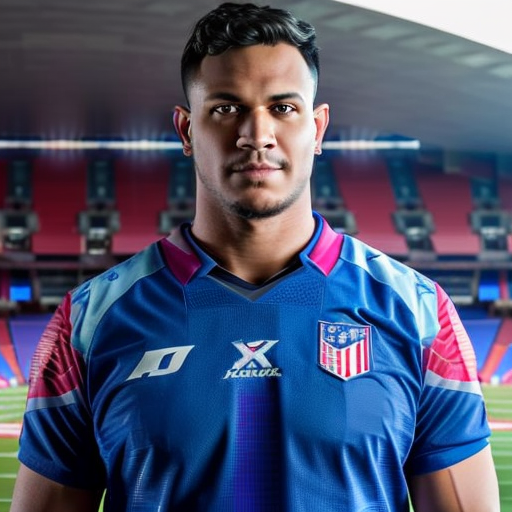

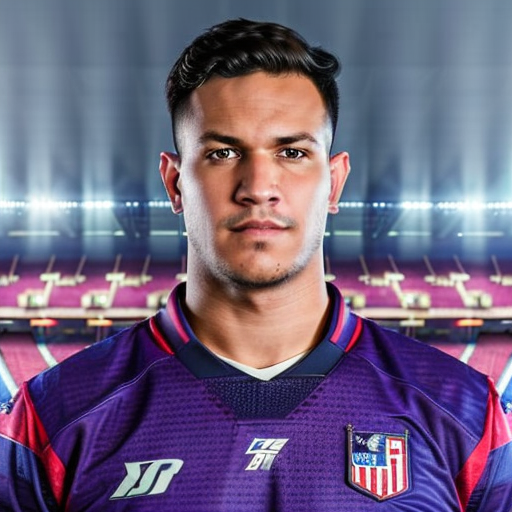

In [12]:
#@title Run for generating images.
import random
g_cuda = torch.Generator(device='cuda')
seed = random.randint(1, 1e16 -1)#@param {type:"number"}
# seed = 4856845480668637
g_cuda.manual_seed(seed)
print(seed)

prompt = "closeup portrait of X123 as a male American footballer with perfect facial features, sporty body. Standing in a stadium wearing football team jersey. Chest level portrait. Octane render, 8K HDR." #@param {type:"string"}
negative_prompt = "multiple person, person in the background, crossed eyes, ((full body)), bare body, ((logo)), blur, freckles, childish, text, symbols" #@param {type:"string"}
num_samples = 4 #@param {type:"number"}
guidance_scale = 14 #@param {type:"number"}
num_inference_steps = 50 #@param {type:"number"}
height = 512 #@param {type:"number"}
width = 512 #@param {type:"number"}


with autocast("cuda"), torch.inference_mode():
    response = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    )
    images = response.images
    print(response.images)
    print(g_cuda.seed())

for img in images:
    display(img)

# a hyper detailed photo realistic horror character portrait, 1 9 8 0 by john totleben, Darrell K Sweet, Wes Wilson, Mark Brooks depicting an alien cyborg [[theCyborg Hacker]], cyberpunk, character portrait

6233039462070004


  0%|          | 0/100 [00:00<?, ?it/s]

[<PIL.Image.Image image mode=RGB size=512x512 at 0x7F0E2719E500>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F0E2719F580>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F0E2719F5E0>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F0E2719D1E0>]
3769616954682494


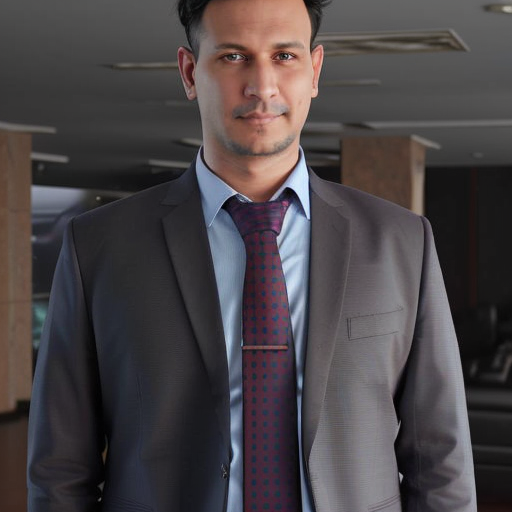

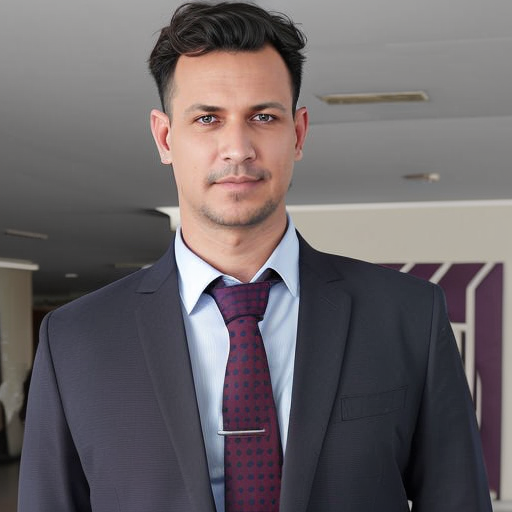

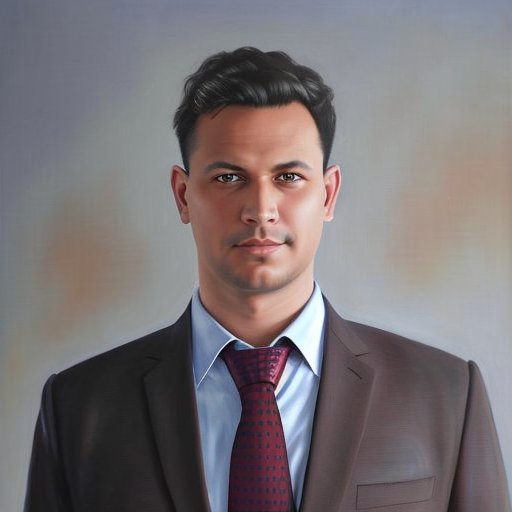

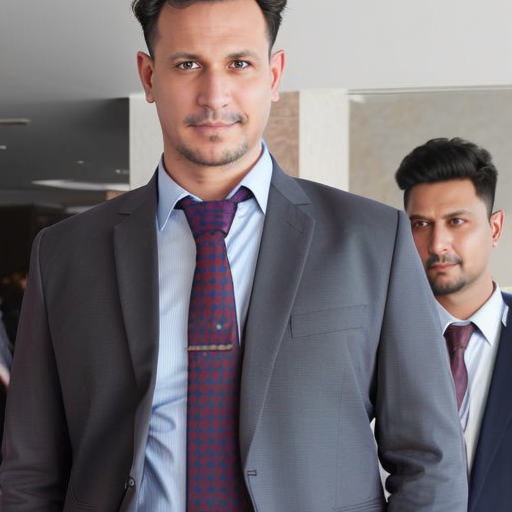

In [14]:
#@title Run for generating images.
import random
g_cuda = torch.Generator(device='cuda')
seed = random.randint(1, 1e16 -1)#@param {type:"number"}
# seed = 4856845480668637
g_cuda.manual_seed(seed)
print(seed)

prompt = "A Nick Alm portrait of X123 with light brown hair done in a hart part style. He has blue eyes, and he wears a khaki-colored two-piece suit with a white shirt and black necktie." #@param {type:"string"}
negative_prompt = "multiple person, person in the background, crossed eyes, ((full body)), bare body, ((logo)), blur, freckles, childish, text, symbols" #@param {type:"string"}
num_samples = 4 #@param {type:"number"}
guidance_scale = 8 #@param {type:"number"}
num_inference_steps = 100 #@param {type:"number"}
height = 512 #@param {type:"number"}
width = 512 #@param {type:"number"}


with autocast("cuda"), torch.inference_mode():
    response = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    )
    images = response.images
    print(response.images)
    print(g_cuda.seed())

for img in images:
    display(img)

# a hyper detailed photo realistic horror character portrait, 1 9 8 0 by john totleben, Darrell K Sweet, Wes Wilson, Mark Brooks depicting an alien cyborg [[theCyborg Hacker]], cyberpunk, character portrait

4944913325067061


  0%|          | 0/100 [00:00<?, ?it/s]

[<PIL.Image.Image image mode=RGB size=512x512 at 0x7F0E27185150>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F0E271854B0>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F0E27184EB0>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F0E27184730>]
2321052137681365


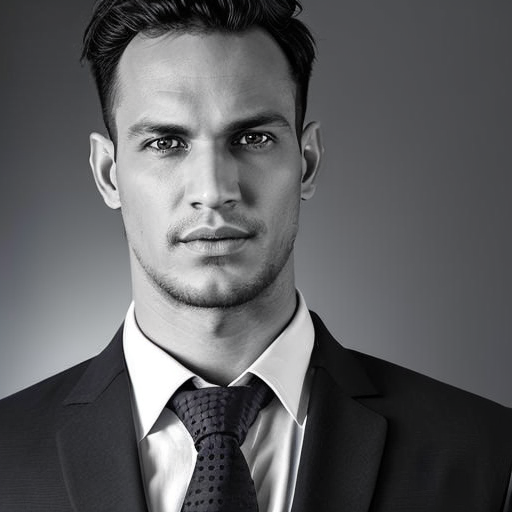

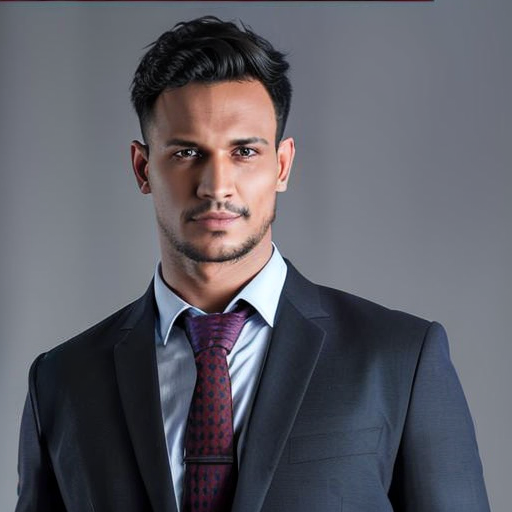

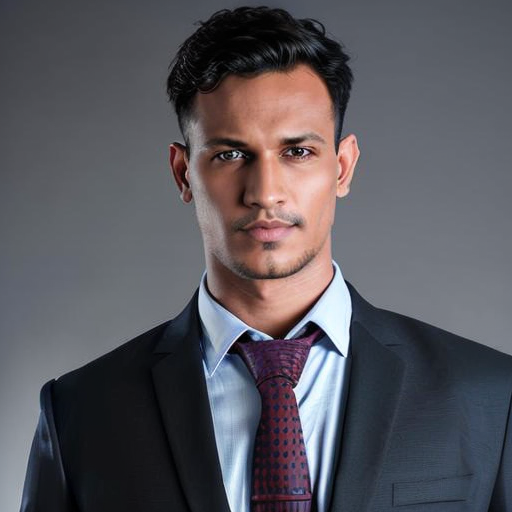

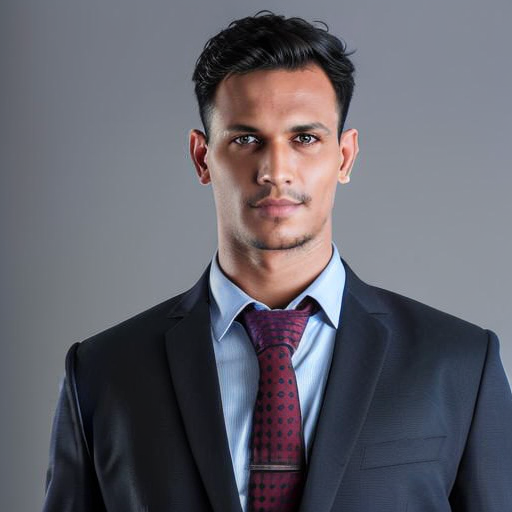

In [19]:
#@title Run for generating images.
import random
g_cuda = torch.Generator(device='cuda')
seed = random.randint(1, 1e16 -1)#@param {type:"number"}
# seed = 4856845480668637
g_cuda.manual_seed(seed)
print(seed)

prompt = "Photo of an X123 as male model, black and white, photorealistic, poster, not painted, very detailed faces, skin with pores,4 k, position from left to right, model looking from left to right over his shoulder, dark suit, black plain background, skin not smoothed, face from left to right" #@param {type:"string"}
negative_prompt = "multiple person, person in the background, crossed eyes, ((full body)), bare body, ((logo)), blur, freckles, childish, text, symbols" #@param {type:"string"}
num_samples = 4 #@param {type:"number"}
guidance_scale = 14 #@param {type:"number"}
num_inference_steps = 100 #@param {type:"number"}
height = 512 #@param {type:"number"}
width = 512 #@param {type:"number"}


with autocast("cuda"), torch.inference_mode():
    response = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    )
    images = response.images
    print(response.images)
    print(g_cuda.seed())

for img in images:
    display(img)

# a hyper detailed photo realistic horror character portrait, 1 9 8 0 by john totleben, Darrell K Sweet, Wes Wilson, Mark Brooks depicting an alien cyborg [[theCyborg Hacker]], cyberpunk, character portrait

In [84]:
import cv2
from PIL import Image
from diffusers import StableDiffusionControlNetPipeline, ControlNetModel, UniPCMultistepScheduler
import torch
import numpy as np
from diffusers.utils import load_image
from IPython.display import display

image = load_image("https://images.unsplash.com/photo-1506794778202-cad84cf45f1d?ixlib=rb-4.0.3&ixid=M3wxMjA3fDB8MHxwaG90by1wYWdlfHx8fGVufDB8fHx8fA%3D%3D&auto=format&fit=crop&w=512&h=764&q=80")
image = np.array(image)

low_threshold = 100
high_threshold = 200

image = cv2.Canny(image, low_threshold, high_threshold)
image = image[:, :, None]
image = np.concatenate([image, image, image], axis=2)
image = Image.fromarray(image)

controlnet = ControlNetModel.from_pretrained(
    "lllyasviel/sd-controlnet-canny", torch_dtype=torch.float16
)

pipe = StableDiffusionControlNetPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5", controlnet=controlnet, safety_checker=None, torch_dtype=torch.float16
)

pipe.scheduler = UniPCMultistepScheduler.from_config(pipe.scheduler.config)

# Remove if you do not have xformers installed
# see https://huggingface.co/docs/diffusers/v0.13.0/en/optimization/xformers#installing-xformers
# for installation instructions
pipe.enable_xformers_memory_efficient_attention()

pipe.enable_model_cpu_offload()

image = pipe("a potrait of a superhero, wearing superhero suite, rainbow background", image, num_inference_steps=50, guidance_scale=20.0).images[0]

display(image)


ModuleNotFoundError: No module named 'cv2'

In [123]:
!pip install opencv-python

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.7/61.7 MB 30.0 MB/s eta 0:00:0000:0100:01

[notice] A new release of pip is available: 23.1.2 -> 23.2.1
[notice] To update, run: python -m pip install --upgrade pip


In [ ]:
!python test_script.py

## Testing another female model

In [3]:
import uuid

In [5]:
uuid.uuid4()

UUID('a14bb049-323e-4cfe-9964-effb46aecd87')

In [11]:
import os
import re
from PIL import Image, ImageOps
import pyheif

def load_image(file_path):
    ext = os.path.splitext(file_path)[1].lower()
    if ext == '.heic':
        heif_file = pyheif.read(file_path)
        return Image.frombytes(
            heif_file.mode, 
            heif_file.size, 
            heif_file.data,
            "raw",
            heif_file.mode,
            heif_file.stride,
        )
    else:
        return Image.open(file_path)

def crop_image(im, resolution=512):
    im = ImageOps.exif_transpose(im)
    (x, y) = im.size
    min_sz = min(x, y)
    left = (x - min_sz) / 2
    top = (y - min_sz) / 2
    right = x - left
    bottom = y - top
    img1 = im.crop((left, top, right, bottom))
    return img1.resize((resolution, resolution))
    
def resize_all(path, resolution=512):
    all_files = os.listdir(path)
    cropped_path = os.path.join(path, 'cropped')
    if not os.path.exists(cropped_path):
        os.mkdir(cropped_path)
    
    for x in all_files:
        if re.search(r'\.(jpg|png|jpeg|heic)$', x, re.IGNORECASE):
            im = load_image(os.path.join(path, x))
            cropped = crop_image(im, resolution)
            new_filename = ''.join(x.split('.')[:-1]) + '.jpg'
            cropped.save(os.path.join(cropped_path, new_filename))

resize_all("/workspace/ds_nickfarrell/data/a14bb049-323e-4cfe-9964-effb46aecd87/a14bb049-323e-4cfe-9964-effb46aecd87", 512)


In [15]:
# You can also add multiple concepts here. Try tweaking `--max_train_steps` accordingly.

concepts_list = [
    {
        "instance_prompt":      "photo of X123 person",
        "class_prompt":         "photo of a person",
        "instance_data_dir":    "/workspace/ds_nickfarrell/data/a14bb049-323e-4cfe-9964-effb46aecd87/a14bb049-323e-4cfe-9964-effb46aecd87/cropped",
        "class_data_dir":       "/workspace/ds_nickfarrell/data/person/"
    }
    # {
#         "instance_prompt":      "photo of ukj person",
#         "class_prompt":         "photo of a person",
#         "instance_data_dir":    "/content/data/ukj",
#         "class_data_dir":       "/content/data/person"
#     }
]

# `class_data_dir` contains regularization images
import json
import os
for c in concepts_list:
    os.makedirs(c["instance_data_dir"], exist_ok=True)

with open("/workspace/ds_nickfarrell/data/a14bb049-323e-4cfe-9964-effb46aecd87/concepts_list.json", "w") as f:
    json.dump(concepts_list, f, indent=4)

In [13]:
#@markdown Name/Path of the initial model.
# MODEL_NAME = "runwayml/stable-diffusion-v1-5" #@param {type:"string"}
MODEL_NAME = "dreamlike-art/dreamlike-photoreal-2.0"
# MODEL_NAME = "SG161222/Realistic_Vision_V5.1_noVAE"


#@markdown Enter the directory name to save model at.

OUTPUT_DIR = "/workspace/ds_nickfarrell/data/a14bb049-323e-4cfe-9964-effb46aecd87/stable_diffusion_weights/a14bb049-323e-4cfe-9964-effb46aecd87" #@param {type:"string"}

print(f"[*] Weights will be saved at {OUTPUT_DIR}")

!mkdir -p $OUTPUT_DIR

[*] Weights will be saved at /workspace/ds_nickfarrell/data/a14bb049-323e-4cfe-9964-effb46aecd87/stable_diffusion_weights/a14bb049-323e-4cfe-9964-effb46aecd87


In [16]:
!python3 train_dreambooth.py \
  --pretrained_model_name_or_path="dreamlike-art/dreamlike-photoreal-2.0" \
  --pretrained_vae_name_or_path="stabilityai/sd-vae-ft-mse" \
  --output_dir="data/a14bb049-323e-4cfe-9964-effb46aecd87/stable_diffusion_weights/a14bb049-323e-4cfe-9964-effb46aecd87" \
  --with_prior_preservation --prior_loss_weight=1.0 \
  --seed=1337 \
  --resolution=512 \
  --train_batch_size=1 \
  --train_text_encoder \
  --mixed_precision="fp16" \
  --use_8bit_adam \
  --gradient_accumulation_steps=1 \
  --learning_rate=1e-6 \
  --lr_scheduler="constant" \
  --lr_warmup_steps=30 \
  --num_class_images=69 \
  --sample_batch_size=4 \
  --max_train_steps=1800 \
  --save_interval=600 \
  --save_sample_prompt="photo of X123 person" \
  --concepts_list="/workspace/ds_nickfarrell/data/a14bb049-323e-4cfe-9964-effb46aecd87/concepts_list.json"

# Reduce the `--save_interval` to lower than `--max_train_steps` to save weights from intermediate steps.
# `--save_sample_prompt` can be same as `--instance_prompt` to generate intermediate samples (saved along with weights in samples directory).

/usr/local/lib/python3.10/dist-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: '/usr/local/lib/python3.10/dist-packages/torchvision/image.so: undefined symbol: _ZN3c1017RegisterOperatorsD1Ev'If you don't plan on using image functionality from `torchvision.io`, you can ignore this warning. Otherwise, there might be something wrong with your environment. Did you have `libjpeg` or `libpng` installed before building `torchvision` from source?
  warn(
Namespace(pretrained_model_name_or_path='dreamlike-art/dreamlike-photoreal-2.0', pretrained_vae_name_or_path='stabilityai/sd-vae-ft-mse', revision=None, tokenizer_name=None, instance_data_dir=None, class_data_dir=None, instance_prompt=None, class_prompt=None, save_sample_prompt='photo of X123 person', save_sample_negative_prompt=None, n_save_sample=4, save_guidance_scale=7.5, save_infer_steps=20, pad_tokens=False, with_prior_preservation=True, prior_loss_weight=1.0, num_class_images=69, output_dir='data

In [17]:
WEIGHTS_DIR= '/workspace/ds_nickfarrell/data/a14bb049-323e-4cfe-9964-effb46aecd87/stable_diffusion_weights/a14bb049-323e-4cfe-9964-effb46aecd87/1200'

In [18]:
#@markdown Run conversion.
ckpt_path = WEIGHTS_DIR + "/model.ckpt"

half_arg = ""
#@markdown  Whether to convert to fp16, takes half the space (2GB).
fp16 = True #@param {type: "boolean"}
if fp16:
    half_arg = "--half"
!python convert_diffusers_to_original_stable_diffusion.py --model_path $WEIGHTS_DIR  --checkpoint_path $ckpt_path $half_arg
print(f"[*] Converted ckpt saved at {ckpt_path}")

Reshaping encoder.mid.attn_1.q.weight for SD format
Reshaping encoder.mid.attn_1.k.weight for SD format
Reshaping encoder.mid.attn_1.v.weight for SD format
Reshaping encoder.mid.attn_1.proj_out.weight for SD format
Reshaping decoder.mid.attn_1.q.weight for SD format
Reshaping decoder.mid.attn_1.k.weight for SD format
Reshaping decoder.mid.attn_1.v.weight for SD format
Reshaping decoder.mid.attn_1.proj_out.weight for SD format
[*] Converted ckpt saved at /workspace/ds_nickfarrell/data/a14bb049-323e-4cfe-9964-effb46aecd87/stable_diffusion_weights/a14bb049-323e-4cfe-9964-effb46aecd87/1200/model.ckpt


In [19]:
import torch
from torch import autocast
from diffusers import StableDiffusionPipeline, DDIMScheduler, DDPMScheduler
from IPython.display import display

# model_path = WEIGHTS_DIR             # If you want to use previously trained model saved in gdrive, replace this with the full path of model in gdrive
model_path = "/workspace/ds_nickfarrell/data/a14bb049-323e-4cfe-9964-effb46aecd87/stable_diffusion_weights/a14bb049-323e-4cfe-9964-effb46aecd87/1200/"
pipe = StableDiffusionPipeline.from_pretrained(model_path, safety_checker=None, torch_dtype=torch.float16).to("cuda")
pipe.scheduler = DDPMScheduler.from_config(pipe.scheduler.config)
pipe.enable_xformers_memory_efficient_attention()
g_cuda = None

7168047986991537


  0%|          | 0/50 [00:00<?, ?it/s]

[<PIL.Image.Image image mode=RGB size=512x512 at 0x7F0C52EBBD00>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F0C52EBB8E0>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F0C52EBBDC0>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F0C52EBBF40>]
352997278476145


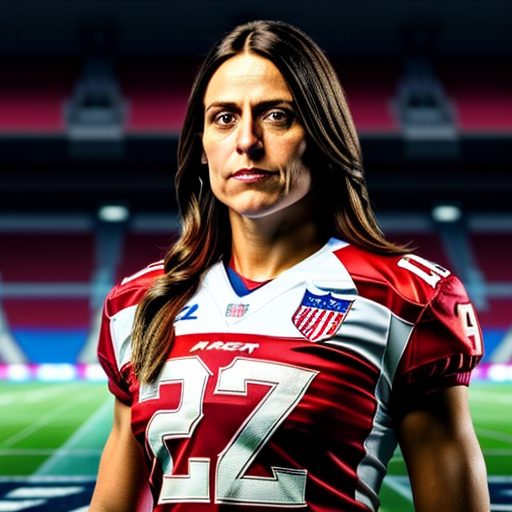

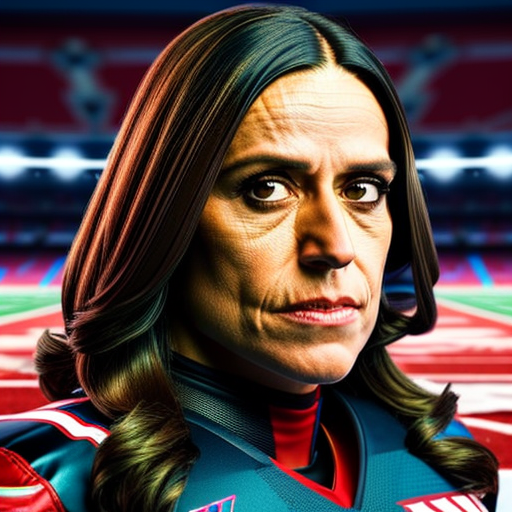

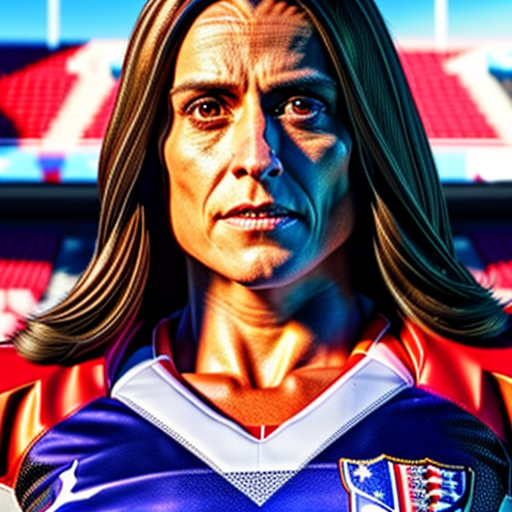

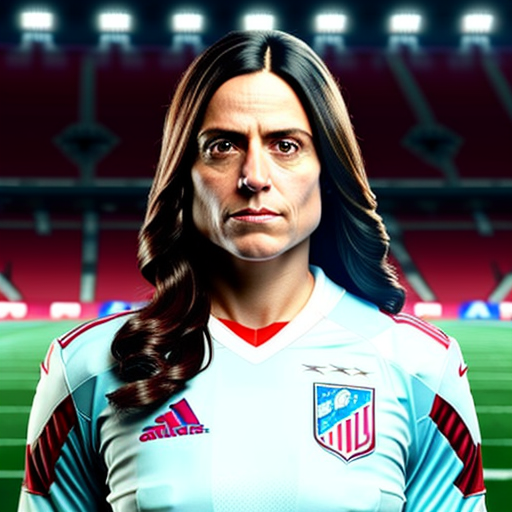

In [21]:
#@title Run for generating images.
import random
g_cuda = torch.Generator(device='cuda')
seed = random.randint(1, 1e16 -1)#@param {type:"number"}
# seed = 4856845480668637
g_cuda.manual_seed(seed)
print(seed)

prompt = "closeup portrait of X123 as a female American footballer with perfect facial features, sporty body. Standing in a stadium wearing football team jersey. Chest level portrait. Octane render, 8K HDR." #@param {type:"string"}
negative_prompt = "multiple person, person in the background, crossed eyes, ((full body)), bare body, ((logo)), blur, freckles, childish, text, symbols" #@param {type:"string"}
num_samples = 4 #@param {type:"number"}
guidance_scale = 14 #@param {type:"number"}
num_inference_steps = 50 #@param {type:"number"}
height = 512 #@param {type:"number"}
width = 512 #@param {type:"number"}


with autocast("cuda"), torch.inference_mode():
    response = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    )
    images = response.images
    print(response.images)
    print(g_cuda.seed())

for img in images:
    display(img)

# a hyper detailed photo realistic horror character portrait, 1 9 8 0 by john totleben, Darrell K Sweet, Wes Wilson, Mark Brooks depicting an alien cyborg [[theCyborg Hacker]], cyberpunk, character portrait

8384002939502507


  0%|          | 0/50 [00:00<?, ?it/s]

[<PIL.Image.Image image mode=RGB size=512x512 at 0x7F0D00785090>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F0C52EBBFA0>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F0C52EBB850>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F0C52EFE2C0>]
8074683638846018


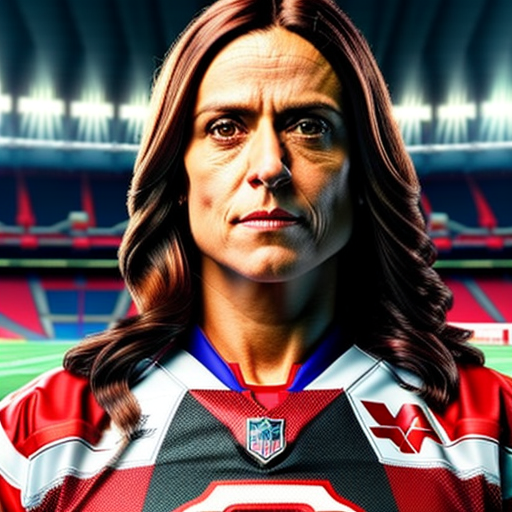

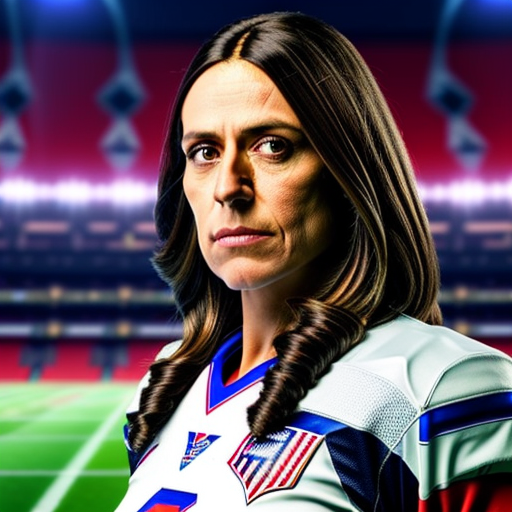

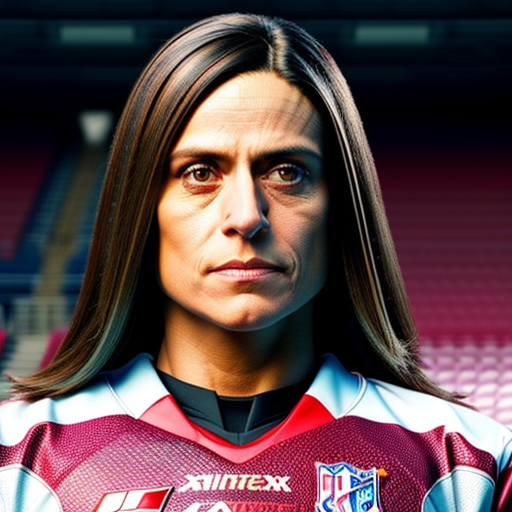

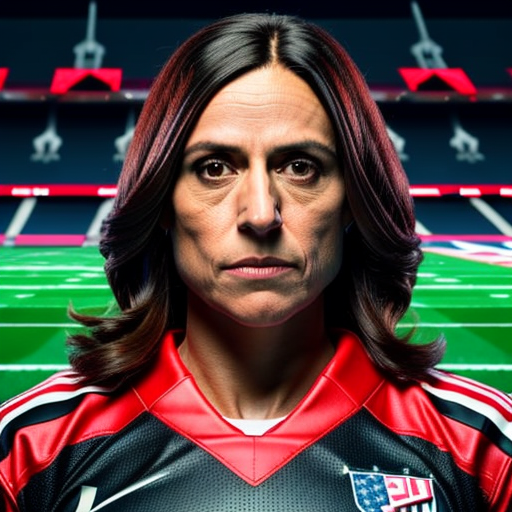

In [22]:
#@title Run for generating images.
import random
g_cuda = torch.Generator(device='cuda')
seed = random.randint(1, 1e16 -1)#@param {type:"number"}
# seed = 4856845480668637
g_cuda.manual_seed(seed)
print(seed)

prompt = "closeup portrait of X123 as a female American footballer with perfect facial features, sporty body. Standing in a stadium wearing football team jersey. Chest level portrait. Octane render, 8K HDR." #@param {type:"string"}
negative_prompt = "multiple person, person in the background, crossed eyes, ((full body)), bare body, ((logo)), blur, freckles, childish, text, symbols" #@param {type:"string"}
num_samples = 4 #@param {type:"number"}
guidance_scale = 14 #@param {type:"number"}
num_inference_steps = 50 #@param {type:"number"}
height = 512 #@param {type:"number"}
width = 512 #@param {type:"number"}


with autocast("cuda"), torch.inference_mode():
    response = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    )
    images = response.images
    print(response.images)
    print(g_cuda.seed())

for img in images:
    display(img)

# a hyper detailed photo realistic horror character portrait, 1 9 8 0 by john totleben, Darrell K Sweet, Wes Wilson, Mark Brooks depicting an alien cyborg [[theCyborg Hacker]], cyberpunk, character portrait

In [23]:
WEIGHTS_DIR= '/workspace/ds_nickfarrell/data/a14bb049-323e-4cfe-9964-effb46aecd87/stable_diffusion_weights/a14bb049-323e-4cfe-9964-effb46aecd87/1800'

In [24]:
#@markdown Run conversion.
ckpt_path = WEIGHTS_DIR + "/model.ckpt"

half_arg = ""
#@markdown  Whether to convert to fp16, takes half the space (2GB).
fp16 = True #@param {type: "boolean"}
if fp16:
    half_arg = "--half"
!python convert_diffusers_to_original_stable_diffusion.py --model_path $WEIGHTS_DIR  --checkpoint_path $ckpt_path $half_arg
print(f"[*] Converted ckpt saved at {ckpt_path}")

Reshaping encoder.mid.attn_1.q.weight for SD format
Reshaping encoder.mid.attn_1.k.weight for SD format
Reshaping encoder.mid.attn_1.v.weight for SD format
Reshaping encoder.mid.attn_1.proj_out.weight for SD format
Reshaping decoder.mid.attn_1.q.weight for SD format
Reshaping decoder.mid.attn_1.k.weight for SD format
Reshaping decoder.mid.attn_1.v.weight for SD format
Reshaping decoder.mid.attn_1.proj_out.weight for SD format
[*] Converted ckpt saved at /workspace/ds_nickfarrell/data/a14bb049-323e-4cfe-9964-effb46aecd87/stable_diffusion_weights/a14bb049-323e-4cfe-9964-effb46aecd87/1800/model.ckpt


In [25]:
import torch
from torch import autocast
from diffusers import StableDiffusionPipeline, DDIMScheduler, DDPMScheduler
from IPython.display import display

# model_path = WEIGHTS_DIR             # If you want to use previously trained model saved in gdrive, replace this with the full path of model in gdrive
model_path = "/workspace/ds_nickfarrell/data/a14bb049-323e-4cfe-9964-effb46aecd87/stable_diffusion_weights/a14bb049-323e-4cfe-9964-effb46aecd87/1800/"
pipe = StableDiffusionPipeline.from_pretrained(model_path, safety_checker=None, torch_dtype=torch.float16).to("cuda")
pipe.scheduler = DDPMScheduler.from_config(pipe.scheduler.config)
pipe.enable_xformers_memory_efficient_attention()
g_cuda = None

5737692952917382


  0%|          | 0/70 [00:00<?, ?it/s]

[<PIL.Image.Image image mode=RGB size=512x512 at 0x7F0C52EFD420>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F0C53F40B50>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F0C53F404F0>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F0C53F40F70>]
4765481305633482


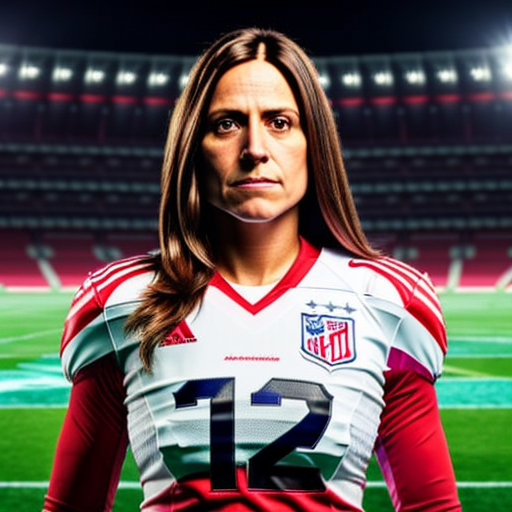

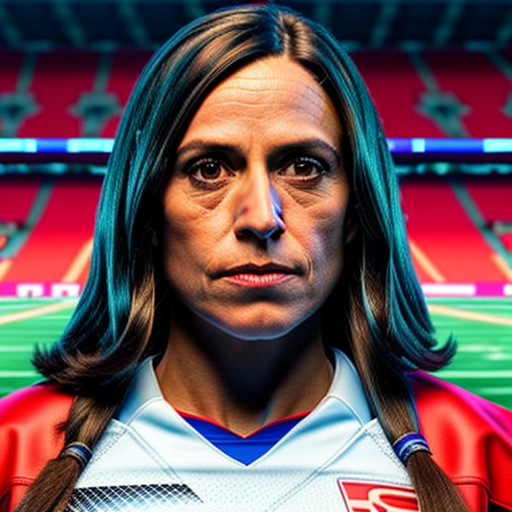

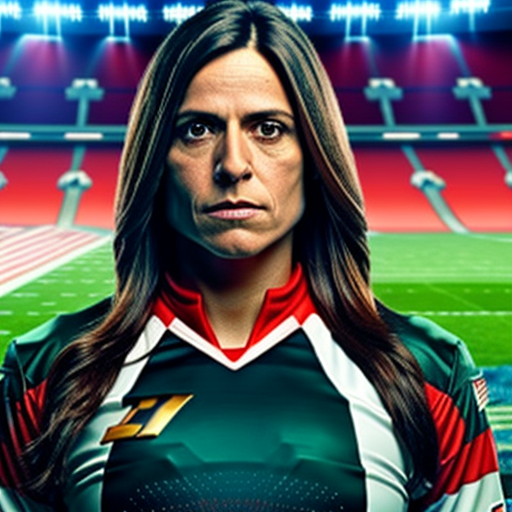

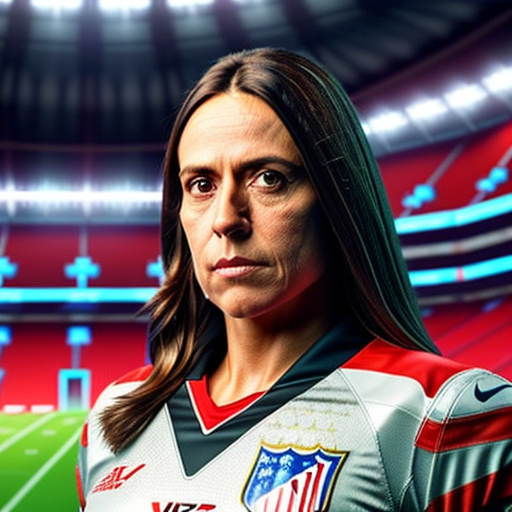

In [28]:
#@title Run for generating images.
import random
g_cuda = torch.Generator(device='cuda')
seed = random.randint(1, 1e16 -1)#@param {type:"number"}
# seed = 4856845480668637
g_cuda.manual_seed(seed)
print(seed)

prompt = "closeup portrait of X123 as a female American footballer with perfect facial features, sporty body. Standing in a stadium wearing football team jersey. Chest level portrait. Octane render, 8K HDR." #@param {type:"string"}
negative_prompt = "multiple person, person in the background, crossed eyes, ((full body)), bare body, ((logo)), blur, freckles, childish, text, symbols" #@param {type:"string"}
num_samples = 4 #@param {type:"number"}
guidance_scale = 12 #@param {type:"number"}
num_inference_steps = 70 #@param {type:"number"}
height = 512 #@param {type:"number"}
width = 512 #@param {type:"number"}


with autocast("cuda"), torch.inference_mode():
    response = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    )
    images = response.images
    print(response.images)
    print(g_cuda.seed())

for img in images:
    display(img)

# a hyper detailed photo realistic horror character portrait, 1 9 8 0 by john totleben, Darrell K Sweet, Wes Wilson, Mark Brooks depicting an alien cyborg [[theCyborg Hacker]], cyberpunk, character portrait

In [29]:
import torch
from torch import autocast
from diffusers import StableDiffusionPipeline, DDIMScheduler, DDPMScheduler
from IPython.display import display

# model_path = WEIGHTS_DIR             # If you want to use previously trained model saved in gdrive, replace this with the full path of model in gdrive
model_path = "/workspace/ds_nickfarrell/data/a14bb049-323e-4cfe-9964-effb46aecd87/stable_diffusion_weights/a14bb049-323e-4cfe-9964-effb46aecd87/1200/"
pipe = StableDiffusionPipeline.from_pretrained(model_path, safety_checker=None, torch_dtype=torch.float16).to("cuda")
pipe.scheduler = DDPMScheduler.from_config(pipe.scheduler.config)
pipe.enable_xformers_memory_efficient_attention()
g_cuda = None

5438745589810680


  0%|          | 0/70 [00:00<?, ?it/s]

[<PIL.Image.Image image mode=RGB size=512x512 at 0x7F0C52E83070>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F0D007BD360>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F0D007BF3A0>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F0D007BD4E0>]
8992552733773306


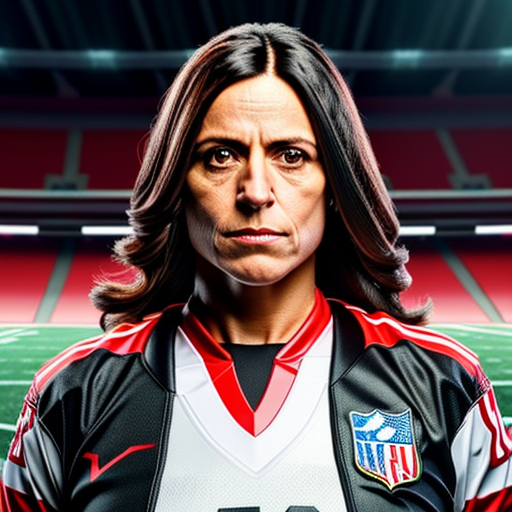

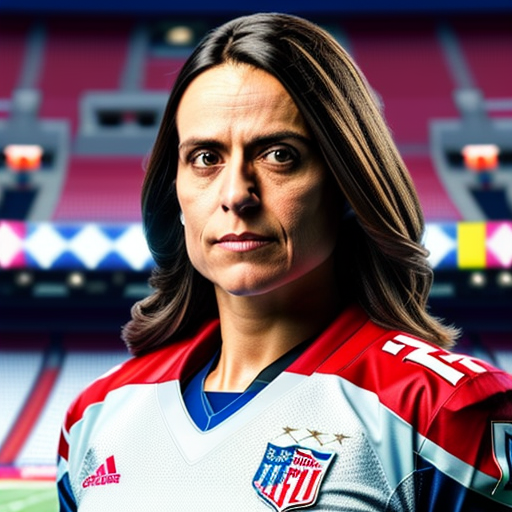

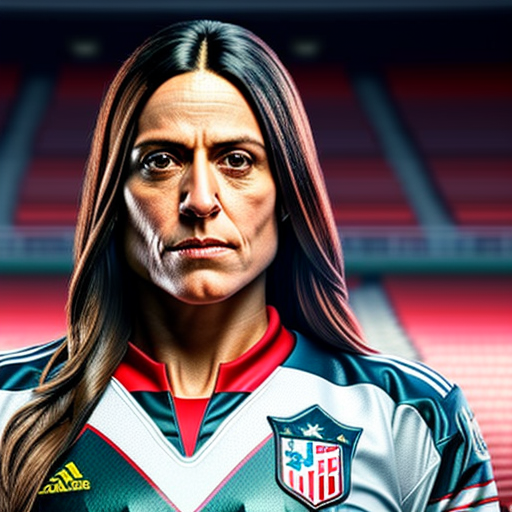

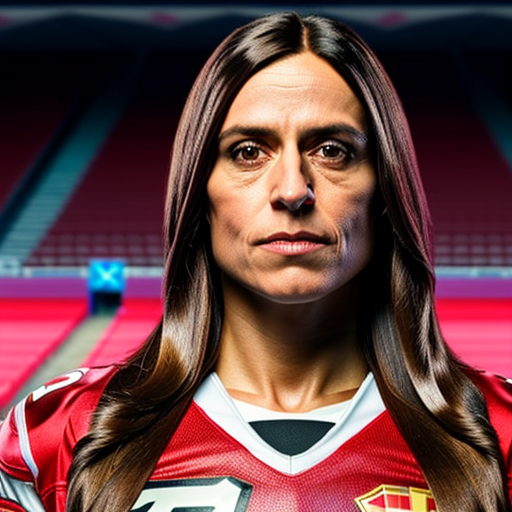

In [30]:
#@title Run for generating images.
import random
g_cuda = torch.Generator(device='cuda')
seed = random.randint(1, 1e16 -1)#@param {type:"number"}
# seed = 4856845480668637
g_cuda.manual_seed(seed)
print(seed)

prompt = "closeup portrait of X123 as a female American footballer with perfect facial features, sporty body. Standing in a stadium wearing football team jersey. Chest level portrait. Octane render, 8K HDR." #@param {type:"string"}
negative_prompt = "multiple person, person in the background, crossed eyes, ((full body)), bare body, ((logo)), blur, freckles, childish, text, symbols" #@param {type:"string"}
num_samples = 4 #@param {type:"number"}
guidance_scale = 14 #@param {type:"number"}
num_inference_steps = 70 #@param {type:"number"}
height = 512 #@param {type:"number"}
width = 512 #@param {type:"number"}


with autocast("cuda"), torch.inference_mode():
    response = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    )
    images = response.images
    print(response.images)
    print(g_cuda.seed())

for img in images:
    display(img)

# a hyper detailed photo realistic horror character portrait, 1 9 8 0 by john totleben, Darrell K Sweet, Wes Wilson, Mark Brooks depicting an alien cyborg [[theCyborg Hacker]], cyberpunk, character portrait

6204221897247370


  0%|          | 0/70 [00:00<?, ?it/s]

[<PIL.Image.Image image mode=RGB size=512x512 at 0x7F0C53F40C70>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F0C53F40A90>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F0C53F40790>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F0C53F40190>]
4805747509996490


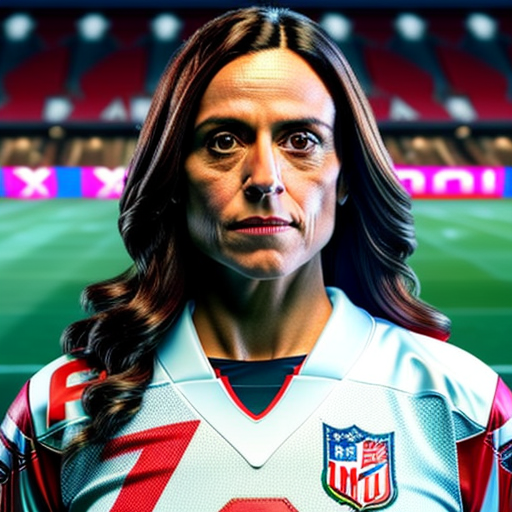

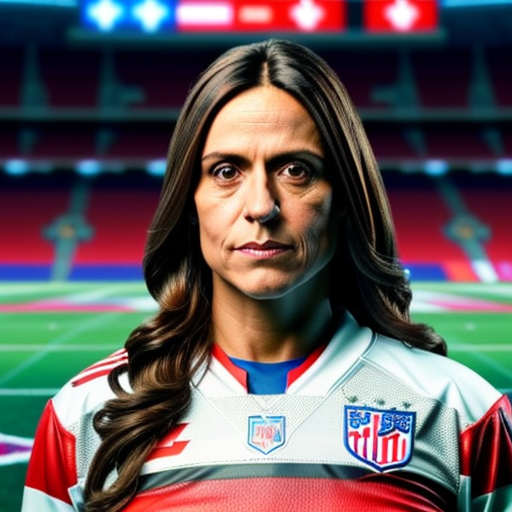

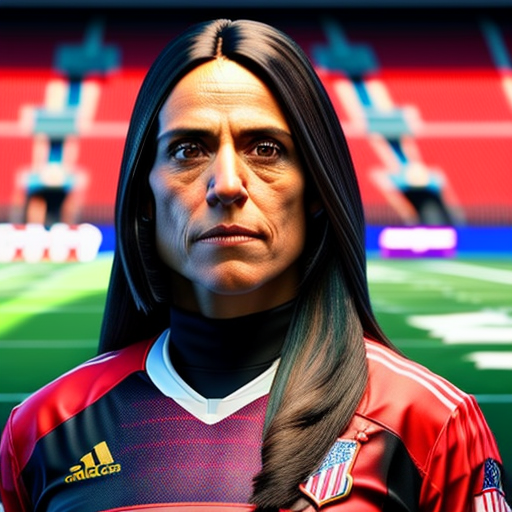

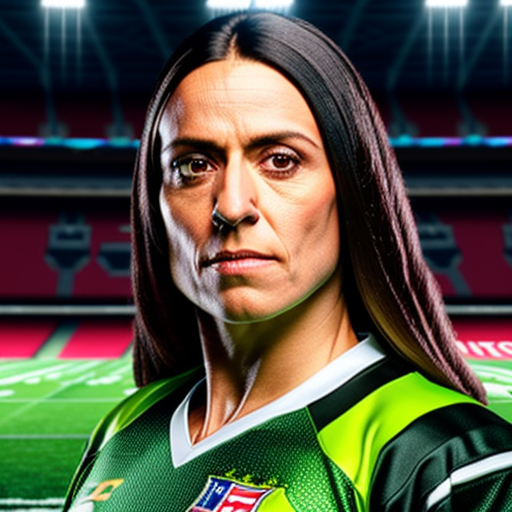

In [34]:
#@title Run for generating images.
import random
g_cuda = torch.Generator(device='cuda')
seed = random.randint(1, 1e16 -1)#@param {type:"number"}
# seed = 4856845480668637
g_cuda.manual_seed(seed)
print(seed)

prompt = "closeup portrait of X123 as a female American footballer with perfect facial features, sporty body. Standing in a stadium wearing football team jersey. Chest level portrait. Octane render, 8K HDR." #@param {type:"string"}
negative_prompt = "multiple person, person in the background, crossed eyes, ((full body)), bare body, ((logo)), blur, freckles, childish, text, symbols" #@param {type:"string"}
num_samples = 4 #@param {type:"number"}
guidance_scale = 14 #@param {type:"number"}
num_inference_steps = 70 #@param {type:"number"}
height = 512 #@param {type:"number"}
width = 512 #@param {type:"number"}


with autocast("cuda"), torch.inference_mode():
    response = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    )
    images = response.images
    print(response.images)
    print(g_cuda.seed())

for img in images:
    display(img)

# a hyper detailed photo realistic horror character portrait, 1 9 8 0 by john totleben, Darrell K Sweet, Wes Wilson, Mark Brooks depicting an alien cyborg [[theCyborg Hacker]], cyberpunk, character portrait

741250057483939


  0%|          | 0/50 [00:00<?, ?it/s]

[<PIL.Image.Image image mode=RGB size=512x512 at 0x7F0D44F839D0>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F0D44F83760>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F0D44F83A30>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F0D007BD1E0>]
5526022935497544


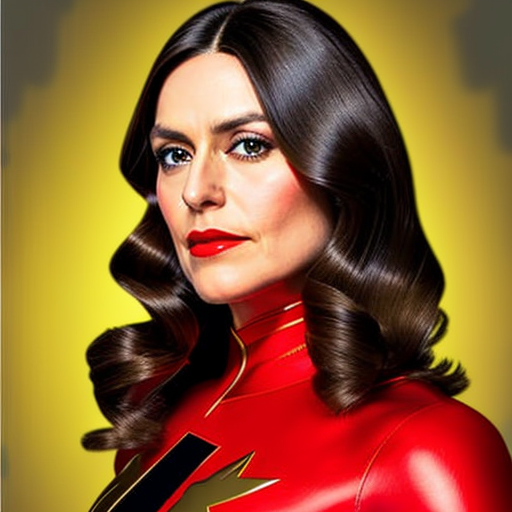

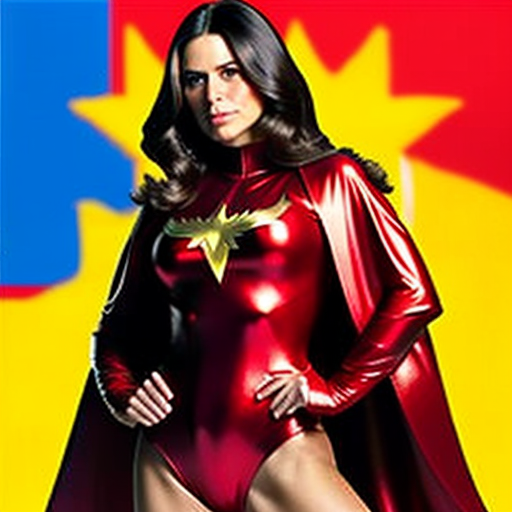

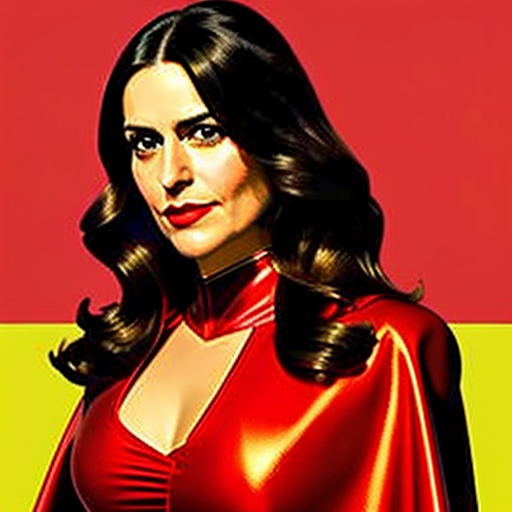

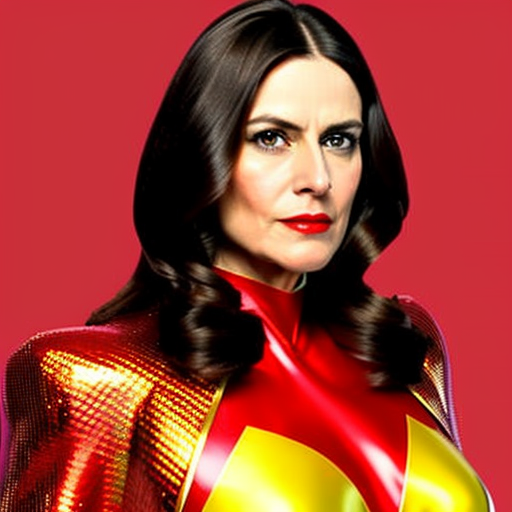

In [50]:
#@title Run for generating images.
import random
g_cuda = torch.Generator(device='cuda')
seed = random.randint(1, 1e16 -1)#@param {type:"number"}
# seed = 4856845480668637
g_cuda.manual_seed(seed)
print(seed)

prompt = "beautiful caped brunette of X123 as female superhero, action pose, fiery red eyes, sharp focus, intricate, highly detailed, art by Andy Warhol, red and gold superhero suit, very feminine, powerful, and fierce, Impressionism, and sparkles surround her." #@param {type:"string"}
negative_prompt = "disfigured, extra fingers, poorly drawn, blurry, low contrast, out of frame, tiling" #@param {type:"string"}
num_samples = 4 #@param {type:"number"}
guidance_scale = 12 #@param {type:"number"}
num_inference_steps = 50 #@param {type:"number"}
height = 512 #@param {type:"number"}
width = 512 #@param {type:"number"}


with autocast("cuda"), torch.inference_mode():
    response = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    )
    images = response.images
    print(response.images)
    print(g_cuda.seed())

for img in images:
    display(img)

# a hyper detailed photo realistic horror character portrait, 1 9 8 0 by john totleben, Darrell K Sweet, Wes Wilson, Mark Brooks depicting an alien cyborg [[theCyborg Hacker]], cyberpunk, character portrait

339228208739464


  0%|          | 0/50 [00:00<?, ?it/s]

[<PIL.Image.Image image mode=RGB size=512x512 at 0x7F0C52EB91E0>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F0C52EB8A90>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F0C53F41240>, <PIL.Image.Image image mode=RGB size=512x512 at 0x7F0D3A634E20>]
6347992916972910


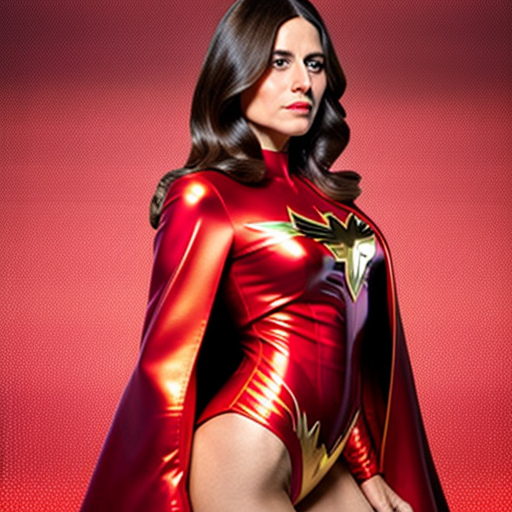

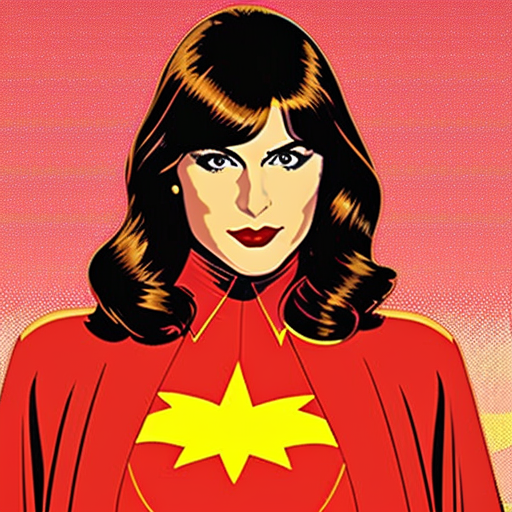

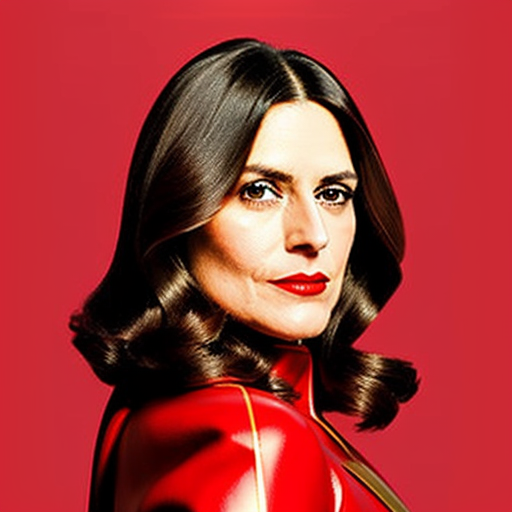

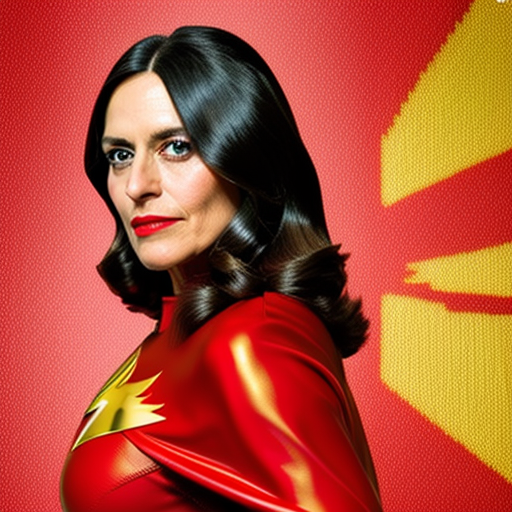

In [52]:
#@title Run for generating images.
import random
g_cuda = torch.Generator(device='cuda')
seed = random.randint(1, 1e16 -1)#@param {type:"number"}
# seed = 4856845480668637
g_cuda.manual_seed(seed)
print(seed)

prompt = "beautiful caped brunette of X123 as female superhero, action pose, fiery red eyes, sharp focus, intricate, highly detailed, art by Andy Warhol, red and gold superhero suit, very feminine, powerful, and fierce, Impressionism, and sparkles surround her." #@param {type:"string"}
negative_prompt = "disfigured, extra fingers, poorly drawn, blurry, low contrast, out of frame, tiling" #@param {type:"string"}
num_samples = 4 #@param {type:"number"}
guidance_scale = 10 #@param {type:"number"}
num_inference_steps = 50 #@param {type:"number"}
height = 512 #@param {type:"number"}
width = 512 #@param {type:"number"}


with autocast("cuda"), torch.inference_mode():
    response = pipe(
        prompt,
        height=height,
        width=width,
        negative_prompt=negative_prompt,
        num_images_per_prompt=num_samples,
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=g_cuda
    )
    images = response.images
    print(response.images)
    print(g_cuda.seed())

for img in images:
    display(img)

# a hyper detailed photo realistic horror character portrait, 1 9 8 0 by john totleben, Darrell K Sweet, Wes Wilson, Mark Brooks depicting an alien cyborg [[theCyborg Hacker]], cyberpunk, character portrait